In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/fashion-product-images-dataset/fashion-dataset/images.csv
/kaggle/input/fashion-product-images-dataset/fashion-dataset/styles.csv
/kaggle/input/fashion-product-images-dataset/fashion-dataset/images/31973.jpg
/kaggle/input/fashion-product-images-dataset/fashion-dataset/images/30778.jpg
/kaggle/input/fashion-product-images-dataset/fashion-dataset/images/19812.jpg
/kaggle/input/fashion-product-images-dataset/fashion-dataset/images/22735.jpg
/kaggle/input/fashion-product-images-dataset/fashion-dataset/images/38246.jpg
/kaggle/input/fashion-product-images-dataset/fashion-dataset/images/16916.jpg
/kaggle/input/fashion-product-images-dataset/fashion-dataset/images/52876.jpg
/kaggle/input/fashion-product-images-dataset/fashion-dataset/images/39500.jpg
/kaggle/input/fashion-product-images-dataset/fashion-dataset/images/44758.jpg
/kaggle/input/fashion-product-images-dataset/fashion-dataset/images/59454.jpg
/kaggle/input/fashion-product-images-dataset/fashion-dataset/images/44951.jp

In [2]:
img_data = pd.read_csv("../input/fashion-product-images-dataset/fashion-dataset/images.csv")

In [3]:
styles_data = pd.read_csv("../input/fashion-product-images-dataset/fashion-dataset/styles.csv", on_bad_lines='skip')

In [4]:
img_data['id'] = img_data['filename'].apply(lambda x: x.replace(".jpg","")).astype(int)

In [5]:
import os

In [6]:
data = styles_data.merge(img_data,on='id',how='left').reset_index(drop=True)
data['filename'] = data['filename'].apply(lambda x: os.path.join("../input/fashion-product-images-dataset/fashion-dataset/images/",x))

In [7]:
data.head()

,id,gender,masterCategory,subCategory,articleType,baseColour,season,year,usage,productDisplayName,filename,link
0,15970,Men,Apparel,Topwear,Shirts,Navy Blue,Fall,2011.0,Casual,Turtle Check Men Navy Blue Shirt,../input/fashion-product-images-dataset/fashio...,http://assets.myntassets.com/v1/images/style/p...
1,39386,Men,Apparel,Bottomwear,Jeans,Blue,Summer,2012.0,Casual,Peter England Men Party Blue Jeans,../input/fashion-product-images-dataset/fashio...,http://assets.myntassets.com/v1/images/style/p...
2,59263,Women,Accessories,Watches,Watches,Silver,Winter,2016.0,Casual,Titan Women Silver Watch,../input/fashion-product-images-dataset/fashio...,http://assets.myntassets.com/v1/images/style/p...
3,21379,Men,Apparel,Bottomwear,Track Pants,Black,Fall,2011.0,Casual,Manchester United Men Solid Black Track Pants,../input/fashion-product-images-dataset/fashio...,http://assets.myntassets.com/v1/images/style/p...
4,53759,Men,Apparel,Topwear,Tshirts,Grey,Summer,2012.0,Casual,Puma Men Grey T-shirt,../input/fashion-product-images-dataset/fashio...,http://assets.myntassets.com/v1/images/style/p...


In [8]:
data.describe()

,id,year
count,44424.000000,44423.000000
mean,29696.334301,2012.806497
std,17049.490518,2.126480
min,1163.000000,2007.000000
25%,14768.750000,2011.000000
50%,28618.500000,2012.000000
75%,44683.250000,2015.000000
max,60000.000000,2019.000000


In [9]:
data.shape

(44424, 12)

**HANDLING WITH IMAGES**

In [10]:
image_files = os.listdir("../input/fashion-product-images-dataset/fashion-dataset/images")

*NOW WE ARE TRYING TO REMOVE THE PRODUCTS FROM DATA FOR WHICH DATA IS NOT PRESENT*

In [11]:
data['file_found'] = data['id'].apply(lambda x: f"{x}.jpg" in image_files)

*DROPPING!!*

In [12]:
data = data[data['file_found']].reset_index(drop=True)

In [13]:
data.shape

(44419, 13)

In [14]:
data.head()


,id,gender,masterCategory,subCategory,articleType,baseColour,season,year,usage,productDisplayName,filename,link,file_found
0,15970,Men,Apparel,Topwear,Shirts,Navy Blue,Fall,2011.0,Casual,Turtle Check Men Navy Blue Shirt,../input/fashion-product-images-dataset/fashio...,http://assets.myntassets.com/v1/images/style/p...,True
1,39386,Men,Apparel,Bottomwear,Jeans,Blue,Summer,2012.0,Casual,Peter England Men Party Blue Jeans,../input/fashion-product-images-dataset/fashio...,http://assets.myntassets.com/v1/images/style/p...,True
2,59263,Women,Accessories,Watches,Watches,Silver,Winter,2016.0,Casual,Titan Women Silver Watch,../input/fashion-product-images-dataset/fashio...,http://assets.myntassets.com/v1/images/style/p...,True
3,21379,Men,Apparel,Bottomwear,Track Pants,Black,Fall,2011.0,Casual,Manchester United Men Solid Black Track Pants,../input/fashion-product-images-dataset/fashio...,http://assets.myntassets.com/v1/images/style/p...,True
4,53759,Men,Apparel,Topwear,Tshirts,Grey,Summer,2012.0,Casual,Puma Men Grey T-shirt,../input/fashion-product-images-dataset/fashio...,http://assets.myntassets.com/v1/images/style/p...,True


**DATA CLEANING**

In [15]:
data.isnull().sum()

id                      0
gender                  0
masterCategory          0
subCategory             0
articleType             0
baseColour             15
season                 21
year                    1
usage                 317
productDisplayName      7
filename                0
link                    0
file_found              0
dtype: int64

In [16]:
data = data.dropna()

In [17]:
data.isnull().sum()

id                    0
gender                0
masterCategory        0
subCategory           0
articleType           0
baseColour            0
season                0
year                  0
usage                 0
productDisplayName    0
filename              0
link                  0
file_found            0
dtype: int64

**VISUALIZATIONZ**

**Histogram for Numeric Variables**

In [18]:
import matplotlib.pyplot as plt
import seaborn as sns

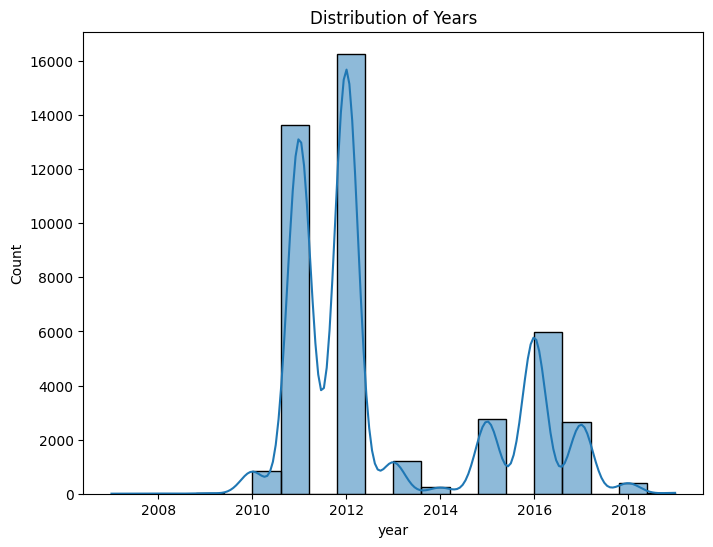

In [19]:
plt.figure(figsize=(8, 6))
sns.histplot(data['year'].dropna(), bins=20, kde=True)
plt.title('Distribution of Years')
plt.show()


**Pairplot for Numeric Variables**

/opt/conda/lib/python3.10/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x800 with 0 Axes>

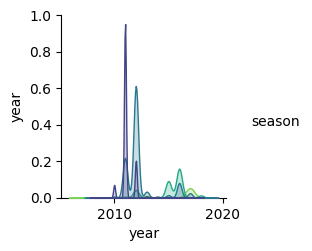

In [20]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 8))
sns.pairplot(data[['year', 'season']], hue='season', palette='viridis', markers=['o', 's'], plot_kws={'alpha': 0.5})
plt.show()


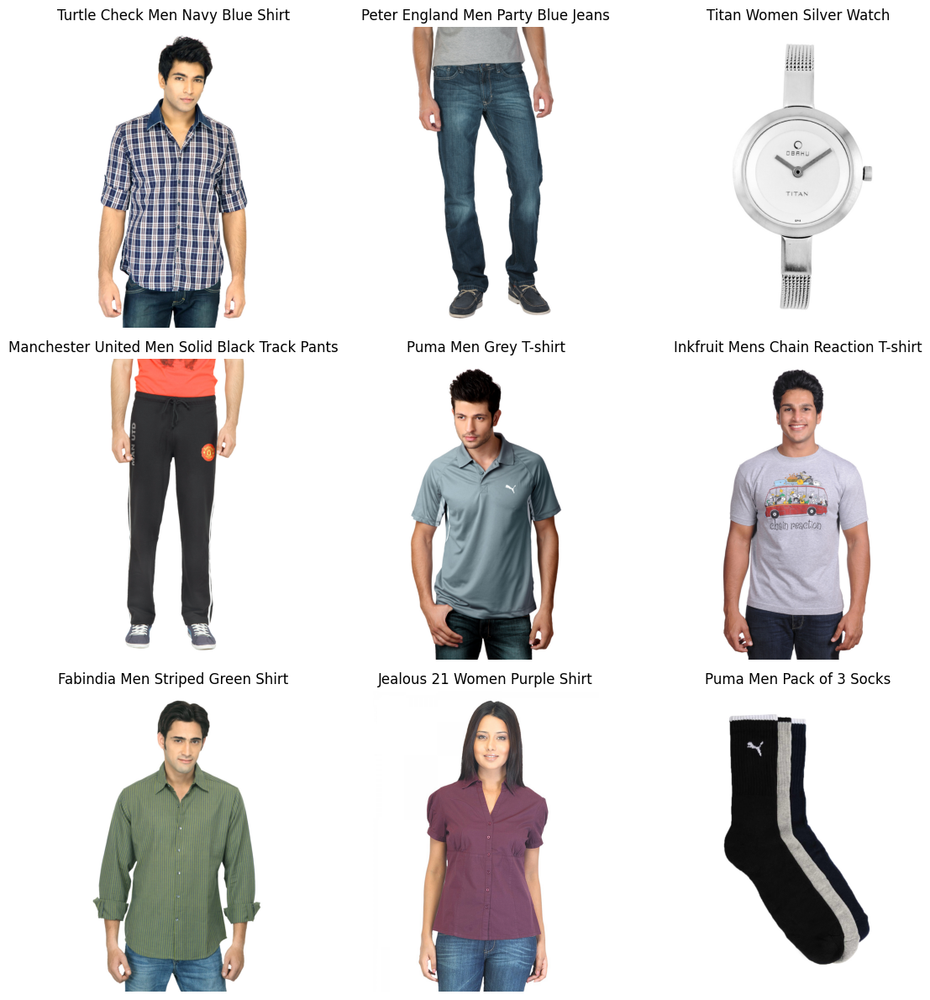

In [21]:
import matplotlib.pyplot as plt
from matplotlib.offsetbox import OffsetImage, AnnotationBbox

plt.figure(figsize=(12, 12))

for i, row in data.head(9).iterrows():
    image_path = row['filename']
    img = plt.imread(image_path)

    ax = plt.subplot(3, 3, i+1)
    plt.imshow(img)
    plt.title(row['productDisplayName'])
    plt.axis('off')

plt.tight_layout()
plt.show()


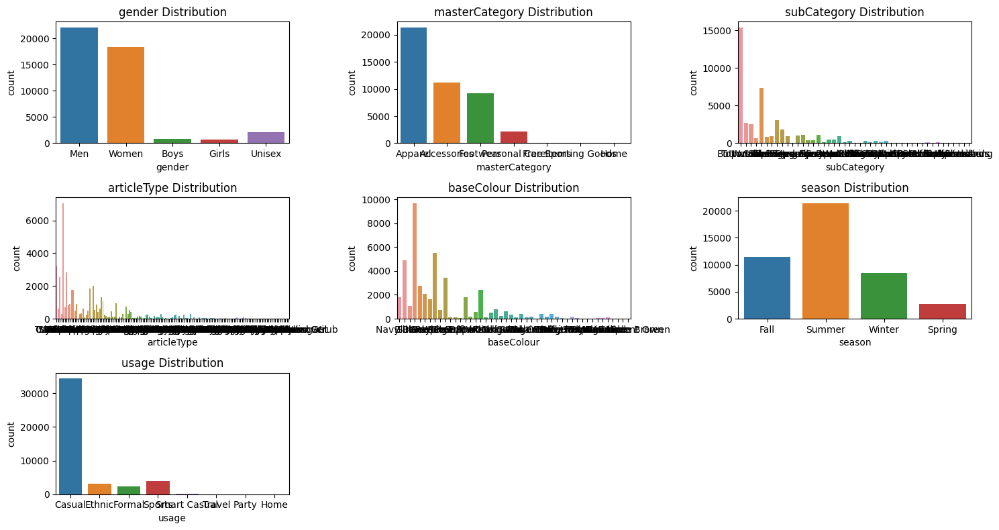

In [22]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(15, 8))

for i, column in enumerate(['gender', 'masterCategory', 'subCategory', 'articleType', 'baseColour', 'season', 'usage']):
    plt.subplot(3, 3, i+1)
    sns.countplot(x=column, data=data)
    plt.title(f'{column} Distribution')

plt.tight_layout()
plt.show()


In [23]:
import plotly.express as px
fig = px.bar(data.groupby('subCategory').count().reset_index(), x='subCategory',y='id',title='Count per Product Sub-category', color='subCategory')
fig.update_layout(barmode='stack', xaxis={'categoryorder':'total descending'})

In [24]:
import plotly.express as px
colors = {
    'Casual': 'orange',
    'Party': 'pink',
    'Formal': 'yellow',
    'Ethnic': 'red'
}

# Create a bar chart with specified colors
fig = px.bar(data.groupby('usage').count().reset_index(), x='usage', y='id', title='Count per Usage Category',
             color='usage', color_discrete_map=colors)

fig.update_layout(barmode='stack', xaxis={'categoryorder': 'total descending'})
fig.show()

In [20]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

In [21]:
data = data.sample(frac=1).reset_index(drop=True)
n = len(data)
train = data.iloc[:int(n*0.8),:]
val = data.iloc[int(n*0.8):,:].reset_index(drop=True)

In [22]:
datagen = ImageDataGenerator(rescale=1/255.)

train_generator = datagen.flow_from_dataframe(dataframe=train,
                                             target_size=(256,256),
                                             x_col='filename',
                                             class_mode=None,
                                             batch_size=32,
                                             shuffle=False,
                                             classes=['images'])

val_generator = datagen.flow_from_dataframe(dataframe=val,
                                             target_size=(256,256),
                                             x_col='filename',
                                             class_mode=None,
                                             batch_size=32,
                                             shuffle=False,
                                             classes=['images'])

/opt/conda/lib/python3.10/site-packages/keras/preprocessing/image.py:1071: UserWarning: `classes` will be ignored given the class_mode="None"
  warnings.warn(


Found 35257 validated image filenames.


/opt/conda/lib/python3.10/site-packages/keras/preprocessing/image.py:1071: UserWarning: `classes` will be ignored given the class_mode="None"
  warnings.warn(


Found 8815 validated image filenames.


In [23]:
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import GlobalAveragePooling2D
from tensorflow.keras.applications import VGG16


In [24]:
base_model = VGG16(weights='/kaggle/input/vggmodels/vgg16_weights_tf_dim_ordering_tf_kernels_notop.h5', include_top=False, input_shape=(224, 224, 3))

model = Sequential()
for layer in base_model.layers:
    model.add(layer)
model.add(GlobalAveragePooling2D())
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0         
                                                                 
 block3_conv1 (Conv2D)       (None, 56, 56, 256)       2

PCA

In [25]:
dummies_df = pd.get_dummies(data, columns=['productDisplayName'])
dummies_df

,id,gender,masterCategory,subCategory,articleType,baseColour,season,year,usage,filename,...,productDisplayName_s.Oliver Women's Department Refined Red T-shirt,productDisplayName_s.Oliver Women's Green Blouse Shirt,productDisplayName_s.Oliver Women's Printed Top Blue T-shirt,productDisplayName_s.Oliver Women's Purple Blouse Top,productDisplayName_s.Oliver Women's Sky Blue Top,productDisplayName_s.Oliver Women's Striped Light Blue Top,productDisplayName_s.Oliver Women's Tank Brown Top,productDisplayName_s.Oliver Women's White Blouse Top,productDisplayName_test dispName,productDisplayName_united Colors Of Benetton Women Grey Tight
0,12142,Women,Apparel,Topwear,Kurtas,Purple,Fall,2011.0,Ethnic,../input/fashion-product-images-dataset/fashio...,...,False,False,False,False,False,False,False,False,False,False
1,49564,Women,Accessories,Bags,Handbags,Brown,Summer,2012.0,Casual,../input/fashion-product-images-dataset/fashio...,...,False,False,False,False,False,False,False,False,False,False
2,7411,Women,Apparel,Topwear,Kurtas,Purple,Summer,2011.0,Ethnic,../input/fashion-product-images-dataset/fashio...,...,False,False,False,False,False,False,False,False,False,False
3,57209,Women,Apparel,Bottomwear,Jeans,Blue,Fall,2012.0,Casual,../input/fashion-product-images-dataset/fashio...,...,False,False,False,False,False,False,False,False,False,False
4,37769,Men,Apparel,Topwear,Shirts,White,Summer,2012.0,Casual,../input/fashion-product-images-dataset/fashio...,...,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
44067,29837,Men,Apparel,Topwear,Shirts,Yellow,Summer,2012.0,Casual,../input/fashion-product-images-dataset/fashio...,...,False,False,False,False,False,False,False,False,False,False
44068,33501,Women,Apparel,Bottomwear,Capris,Pink,Summer,2012.0,Casual,../input/fashion-product-images-dataset/fashio...,...,False,False,False,False,False,False,False,False,False,False
44069,54533,Men,Footwear,Shoes,Sports Shoes,Black,Fall,2012.0,Sports,../input/fashion-product-images-dataset/fashio...,...,False,False,False,False,False,False,False,False,False,False
44070,8276,Men,Apparel,Topwear,Tshirts,Grey,Fall,2011.0,Casual,../input/fashion-product-images-dataset/fashio...,...,False,False,False,False,False,False,False,False,False,False


In [26]:
data1=dummies_df.drop(['filename','id','link','gender','masterCategory','subCategory','articleType','baseColour','season','year','usage'],axis=1)
data1

,file_found,productDisplayName_109F Blue A-Line Dress,productDisplayName_109F Red & White A-Line Dress,productDisplayName_109F Women Beige Embroidered Top,productDisplayName_109F Women Black & Cream Dress,productDisplayName_109F Women Black & Cream-Coloured Colourblocked Printed Tunic,productDisplayName_109F Women Black & White Top,productDisplayName_109F Women Black Embellished Tunic,productDisplayName_109F Women Black Printed Kaftan Tunic,productDisplayName_109F Women Black Printed Tunic,...,productDisplayName_s.Oliver Women's Department Refined Red T-shirt,productDisplayName_s.Oliver Women's Green Blouse Shirt,productDisplayName_s.Oliver Women's Printed Top Blue T-shirt,productDisplayName_s.Oliver Women's Purple Blouse Top,productDisplayName_s.Oliver Women's Sky Blue Top,productDisplayName_s.Oliver Women's Striped Light Blue Top,productDisplayName_s.Oliver Women's Tank Brown Top,productDisplayName_s.Oliver Women's White Blouse Top,productDisplayName_test dispName,productDisplayName_united Colors Of Benetton Women Grey Tight
0,True,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
1,True,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2,True,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
3,True,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
4,True,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
44067,True,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
44068,True,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
44069,True,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
44070,True,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False


In [27]:
your_data = data1.to_numpy()
your_data

array([[ True, False, False, ..., False, False, False],
       [ True, False, False, ..., False, False, False],
       [ True, False, False, ..., False, False, False],
       ...,
       [ True, False, False, ..., False, False, False],
       [ True, False, False, ..., False, False, False],
       [ True, False, False, ..., False, False, False]])

In [36]:
from sklearn.decomposition import PCA

# Create a PCA object with the desired number of components (e.g., 2 for 2D visualization).
pca = PCA(n_components=2)

# Fit the PCA model to your data and transform it to the reduced dimensionality.
reduced_data = pca.fit_transform(your_data)

# 'reduced_data' now contains the data in the reduced dimensionality.
reduced_data

array([[-0.00181116, -0.00120804],
       [-0.00178877, -0.00118612],
       [-0.00178877, -0.00118612],
       ...,
       [-0.00178877, -0.00118612],
       [-0.00178877, -0.00118612],
       [-0.00178877, -0.00118612]])

In [37]:
train


,id,gender,masterCategory,subCategory,articleType,baseColour,season,year,usage,productDisplayName,filename,link,file_found
0,42331,Women,Apparel,Saree,Sarees,Navy Blue,Summer,2012.0,Ethnic,Prafful Navy Crepe Printed Saree,../input/fashion-product-images-dataset/fashio...,http://assets.myntassets.com/v1/images/style/p...,True
1,20988,Unisex,Accessories,Belts,Belts,Black,Winter,2016.0,Casual,Fastrack Unisex Polyester Black Belt,../input/fashion-product-images-dataset/fashio...,http://assets.myntassets.com/v1/images/style/p...,True
2,2112,Women,Apparel,Bottomwear,Track Pants,Black,Fall,2010.0,Sports,ADIDAS Women's Essential Black Capris,../input/fashion-product-images-dataset/fashio...,http://assets.myntassets.com/v1/images/style/p...,True
3,5774,Women,Apparel,Topwear,Tops,White,Summer,2011.0,Casual,Jealous 21 Women's White Sleeveless Graphic Top,../input/fashion-product-images-dataset/fashio...,http://assets.myntassets.com/v1/images/style/p...,True
4,11799,Women,Apparel,Topwear,Kurtas,Maroon,Fall,2011.0,Ethnic,Vishudh Women Pigment Print Maroon Kurtas,../input/fashion-product-images-dataset/fashio...,http://assets.myntassets.com/v1/images/style/p...,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...
35252,51027,Women,Apparel,Innerwear,Bra,Brown,Summer,2017.0,Casual,Enamor Brown Smooth Bra,../input/fashion-product-images-dataset/fashio...,http://assets.myntassets.com/v1/images/style/p...,True
35253,17971,Men,Footwear,Sandal,Sandals,Black,Fall,2011.0,Casual,Puma Men Rio Black Sandal,../input/fashion-product-images-dataset/fashio...,http://assets.myntassets.com/v1/images/style/p...,True
35254,36288,Women,Apparel,Loungewear and Nightwear,Night suits,Pink,Summer,2017.0,Casual,SDL by Sweet Dreams Women Pink Night suits,../input/fashion-product-images-dataset/fashio...,http://assets.myntassets.com/v1/images/style/p...,True
35255,18208,Men,Accessories,Headwear,Caps,White,Fall,2011.0,Casual,Manchester United Men Solid White Cap,../input/fashion-product-images-dataset/fashio...,http://assets.myntassets.com/v1/images/style/p...,True


In [44]:
train_pca = pd.DataFrame(reduced_data)
train = train.iloc[:,0:10]
train = train.merge(train_pca, how='left', left_index=True, right_index=True)

In [45]:
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming 'reduced_data' contains the PCA-transformed data
x_values = reduced_data[:, 0]  # First principal component
y_values = reduced_data[:, 1]  # Second principal component

# Use the 'masterCategory' column as the category
categories = your_data['masterCategory'].values

# Create a scatter plot with color coding
plt.figure(figsize=(8, 6))
sns.scatterplot(x=x_values, y=y_values, hue=categories, palette='viridis')
plt.title('PCA Scatter Plot with Color Coding by Master Category')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend(title='Master Category')
plt.show()


IndexError: only integers, slices (`:`), ellipsis (`...`), numpy.newaxis (`None`) and integer or boolean arrays are valid indices

In [46]:
pca = PCA()
pca.fit(reduced_data)
train_pca = pca.transform(reduced_data)
variance_explained = np.cumsum(pca.explained_variance_ratio_)
pcs = range(1,len(variance_explained)+1)
pcs

range(1, 3)

In [47]:
px.line(x = pcs, y = variance_explained, title = 'Principal Components Cumulative Explained Variance', height=600,  labels={
                     "x": "Principal Components",
                     "y": "Explained Variance"})

In [28]:
train_features = model.predict(train_generator,verbose=1)
val_features = model.predict(val_generator,verbose=1)

276/276 [==============================] - 3373s 12s/step


In [31]:
from sklearn.decomposition import PCA

In [32]:
pca = PCA(2)
pca.fit(train_features)
train_pca = pca.transform(train_features)

In [33]:
test_pca = pca.fit_transform(val_features)

In [34]:
train_pca = pd.DataFrame(train_pca)
train = train.iloc[:,0:10]
train = train.merge(train_pca, how='left', left_index=True, right_index=True)

In [36]:
import plotly.express as px

In [37]:
fig = px.scatter(train, x=0, y=1, color="masterCategory", title='Main Category', height=600, labels={
                     "0": "Principal Component 1",
                     "1": "Principal Component 2"})
fig.show()

In [38]:
fig = px.scatter(train, x=0, y=1, color="gender", title='Gender', height=600, labels={
                     "0": "Principal Component 1",
                     "1": "Principal Component 2"})
fig.show()

In [39]:
fig = px.scatter(train, x=0, y=1, color="subCategory", title='Sub Category', height=600, labels={
                     "0": "Principal Component 1",
                     "1": "Principal Component 2"})
fig.show()

In [40]:
fig = px.scatter(train[train['season'].notna()], x=0, y=1, color="season", title='Season', height=600, labels={
                     "0": "Principal Component 1",
                     "1": "Principal Component 2"})
fig.show()

In [41]:
fig = px.scatter(train[train['usage'].notna()], x=0, y=1, color="usage", title='Usage', height=600, labels={
                     "0": "Principal Component 1",
                     "1": "Principal Component 2"})
fig.show()

In [42]:
pca = PCA()
pca.fit(train_features)
train_pca = pca.transform(train_features)
variance_explained = np.cumsum(pca.explained_variance_ratio_)
pcs = range(1,len(variance_explained)+1)

In [43]:
px.line(x = pcs, y = variance_explained, title = 'Principal Components Cumulative Explained Variance', height=600,  labels={
                     "x": "Principal Components",
                     "y": "Explained Variance"})

In [62]:
val_pca = pca.fit_transform(val_features)[:,:313]
val_pca = pd.DataFrame(val_pca)
val = val.iloc[:,0:10]
val = val.merge(val_pca, how='left', left_index=True, right_index=True)
print(val.columns)

Index([                'id',             'gender',     'masterCategory',
              'subCategory',        'articleType',         'baseColour',
                   'season',               'year',              'usage',
       'productDisplayName',
       ...
                        303,                  304,                  305,
                        306,                  307,                  308,
                        309,                  310,                  311,
                        312],
      dtype='object', length=323)


In [64]:
X = val.iloc[:,-313:]
y = val['id']


In [46]:
from sklearn.neighbors import KNeighborsClassifier

neigh = KNeighborsClassifier(n_neighbors=6)
neigh.fit(X, y)

KNeighborsClassifier(n_neighbors=6)

In [47]:
def read_img(image_path):
    image = load_img(image_path,target_size=(256,256,3))
    image = img_to_array(image)
    image = image/255.
    return image

In [48]:
import random

In [56]:
print(val)

         id  gender masterCategory subCategory   articleType baseColour  \
0      5135   Women        Apparel     Topwear       Tshirts       Blue   
1     25162   Women    Accessories        Bags      Handbags      Black   
2     21467   Women       Footwear       Shoes  Casual Shoes      Brown   
3      5441   Girls        Apparel     Topwear          Tops     Purple   
4     32861  Unisex    Accessories        Bags     Backpacks       Grey   
...     ...     ...            ...         ...           ...        ...   
8810  29837     Men        Apparel     Topwear        Shirts     Yellow   
8811  33501   Women        Apparel  Bottomwear        Capris       Pink   
8812  54533     Men       Footwear       Shoes  Sports Shoes      Black   
8813   8276     Men        Apparel     Topwear       Tshirts       Grey   
8814  51805   Women        Apparel   Innerwear           Bra       Pink   

      season    year   usage                               productDisplayName  \
0     Summer  2011

In [70]:
from tensorflow.keras.preprocessing.image import load_img,img_to_array

Nearest Neighbors Indices: [[1846 1159 3041 3872 5509 3249]]
Nearest Neighbors Indices: [[5892 4453 8026 8368 1061 3787]]
Nearest Neighbors Indices: [[7331 3384 3263 1834 3823 5260]]
Nearest Neighbors Indices: [[3252 7081  152 8536 4676  734]]
Nearest Neighbors Indices: [[1898 1454 8196 6730 3851 4045]]
Nearest Neighbors Indices: [[3850 8179 5623 5119 6381 5394]]
Nearest Neighbors Indices: [[4785 6933 3288 7927 1071 4335]]
Nearest Neighbors Indices: [[5725 8283 5017 5127 2227 1329]]
Nearest Neighbors Indices: [[5214 3219 4787 5772 2805 7931]]
Nearest Neighbors Indices: [[3865 1224 8640 7246 8435 6419]]


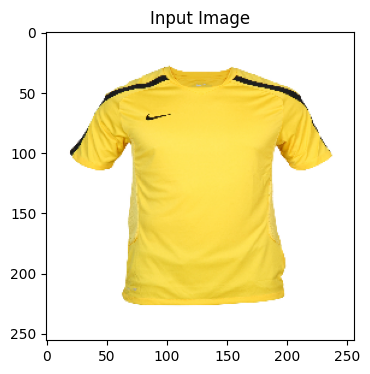

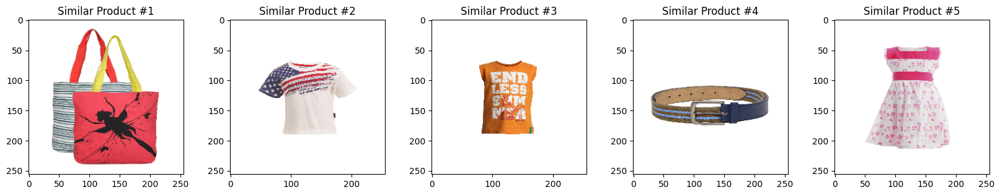

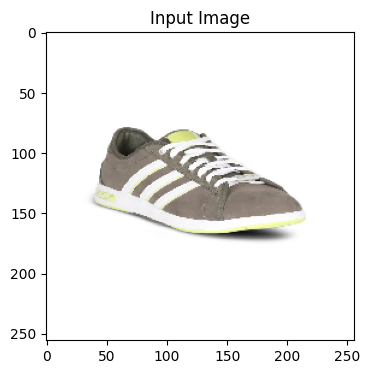

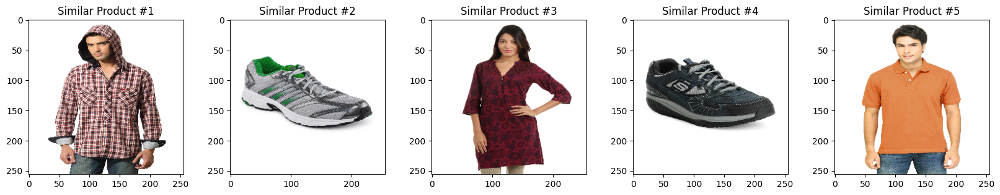

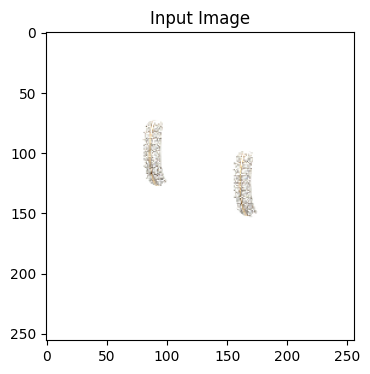

...

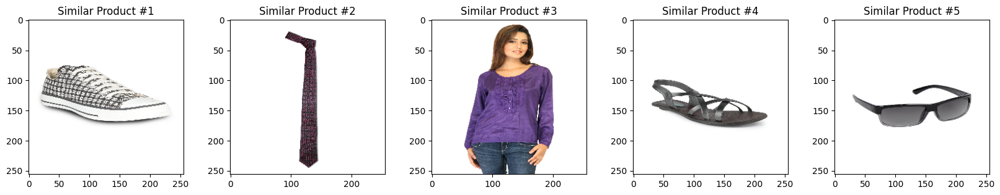

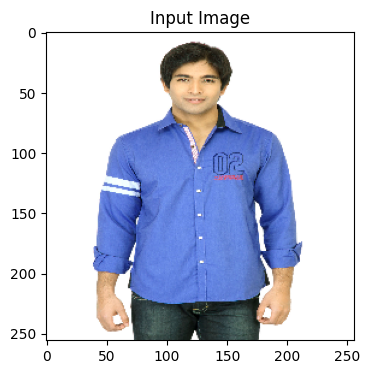

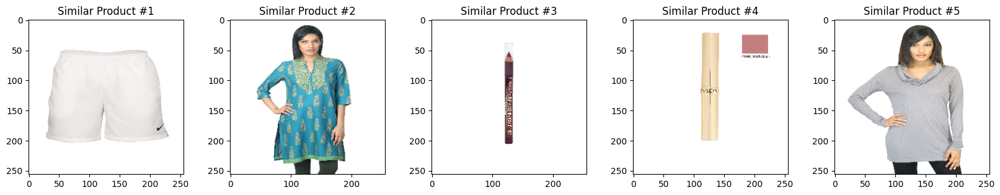

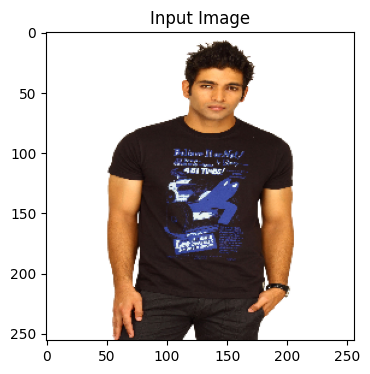

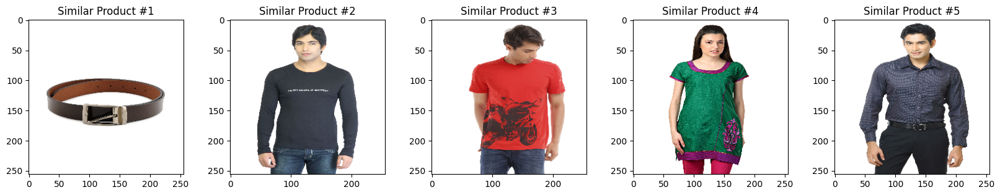

In [72]:
for _ in range(10):
    i = random.randint(1,len(val))
    img1 = read_img(data.loc[i,'filename'])
    dist, index = neigh.kneighbors(X=X.iloc[i, :].values.reshape(1, -1))
    print("Nearest Neighbors Indices:", index)
    plt.figure(figsize = (4 , 4))
    plt.imshow(img1)
    plt.title("Input Image")

    plt.figure(figsize = (20 , 20))
    for i in range(1,6):
        plt.subplot(1 , 5, i)
        plt.subplots_adjust(hspace = 0.5 , wspace = 0.3)
        image = read_img(data.loc[index[0][i],'filename'])
        plt.imshow(image)
        plt.title(f'Similar Product #{i}')

In [65]:
print(data.columns)

Index(['id', 'gender', 'masterCategory', 'subCategory', 'articleType',
       'baseColour', 'season', 'year', 'usage', 'productDisplayName',
       'filename', 'link', 'file_found'],
      dtype='object')
